path to dataset: /content/tablea1.csv

In [ ]:
pip install lime shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=dc331a9ccf529fb954e56217808005186a1c40599570accf7e3cbc40a048f968
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


# **Linear Regression**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
data[features] = (data[features] - data[features].min()) / (data[features].max() - data[features].min())

# Split the data into train and test sets
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize Random Forest Regressor
rf_model = RandomForestRegressor(random_state=42, n_estimators=100)
rf_model.fit(X_train, y_train)

# Predict and calculate metrics
y_pred = rf_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)



Metrics: {'RMSE': 0.03416245722152199, 'MSE': 0.0011670734834123197, 'MAE': 0.026377488151658742, 'R^2': 0.9818613917557066, 'Accuracy RMSE': 97.08013186140838, 'Accuracy MSE': 99.90025012962288, 'Accuracy MAE': 97.74551383319157}


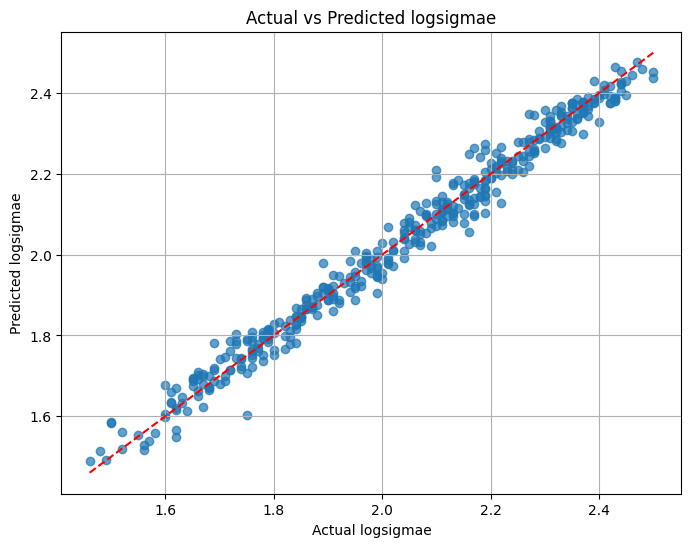

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


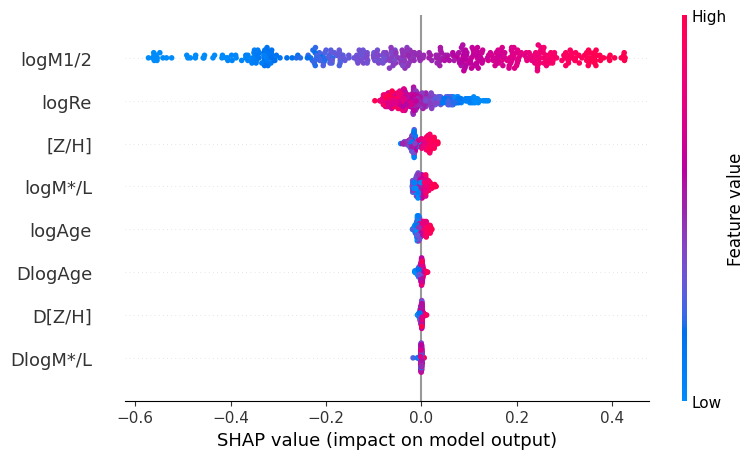

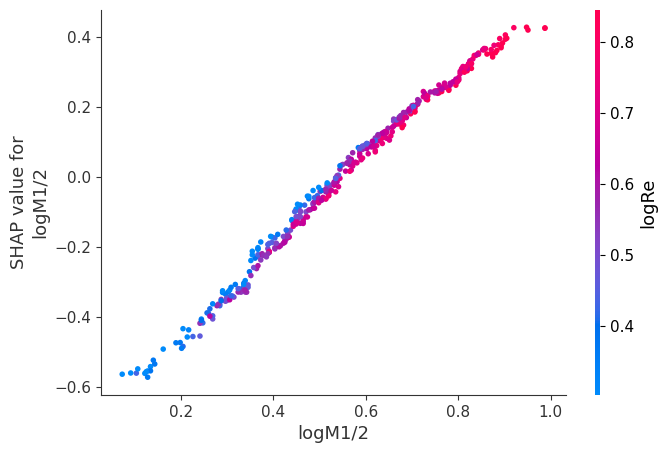

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    training_labels=y_train.values,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test.iloc[sample_index].values,
    rf_model.predict,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.Explainer(rf_model, X_train)
shap_values = explainer(X_test)

# SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=features)

# SHAP dependence plot for a specific feature
shap.dependence_plot(0, shap_values.values, X_test, feature_names=features)


# **Random Forest**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
data[features] = (data[features] - data[features].min()) / (data[features].max() - data[features].min())

# Split the data into train and test sets
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize Random Forest Regressor
rf_model = RandomForestRegressor(random_state=42, n_estimators=100)
rf_model.fit(X_train, y_train)

# Predict and calculate metrics
y_pred = rf_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Metrics: {'RMSE': 0.03416245722152199, 'MSE': 0.0011670734834123197, 'MAE': 0.026377488151658742, 'R^2': 0.9818613917557066, 'Accuracy RMSE': 97.08013186140838, 'Accuracy MSE': 99.90025012962288, 'Accuracy MAE': 97.74551383319157}


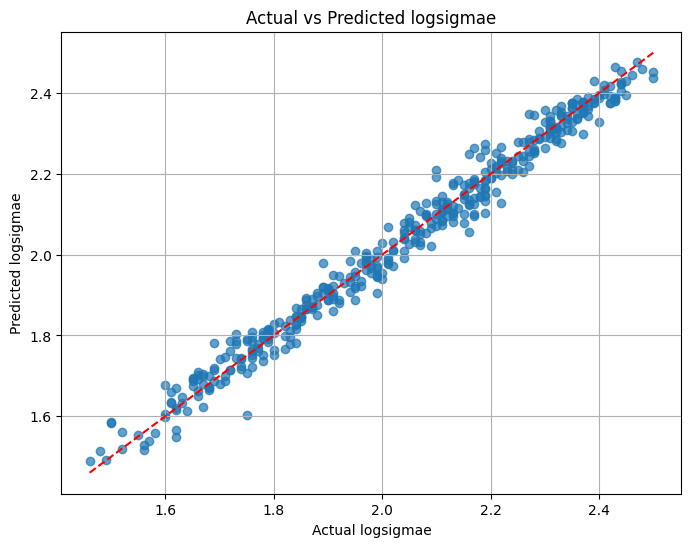

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


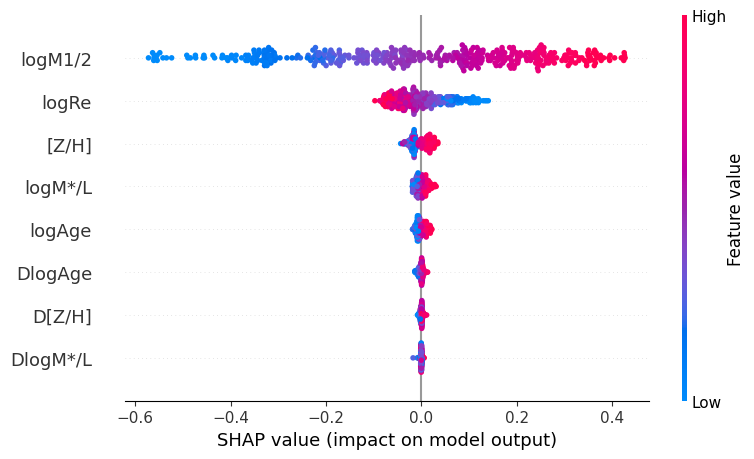

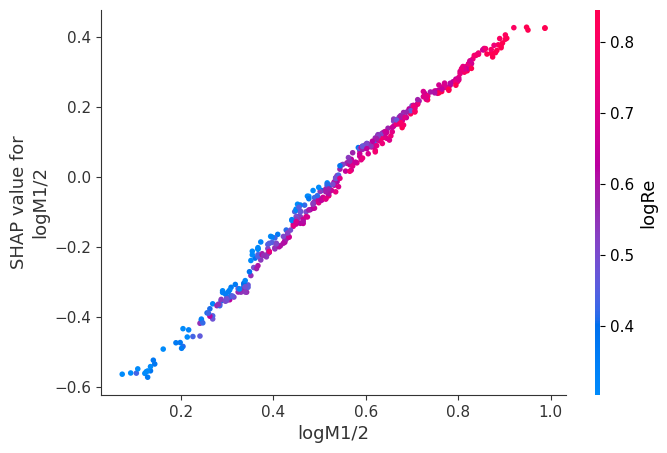

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    training_labels=y_train.values,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test.iloc[sample_index].values,
    rf_model.predict,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.Explainer(rf_model, X_train)
shap_values = explainer(X_test)

# SHAP summary plot
shap.summary_plot(shap_values.values, X_test, feature_names=features)

# SHAP dependence plot for a specific feature (e.g., first feature)
shap.dependence_plot(0, shap_values.values, X_test, feature_names=features)

# **Decision Tree**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
data[features] = (data[features] - data[features].min()) / (data[features].max() - data[features].min())

# Split the data into train and test sets
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize Decision Tree Regressor
dt_model = DecisionTreeRegressor(random_state=42)
dt_model.fit(X_train, y_train)

# Predict and calculate metrics
y_pred = dt_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Metrics: {'RMSE': 0.05369300130022154, 'MSE': 0.0028829383886255916, 'MAE': 0.04113744075829383, 'R^2': 0.955193489727125, 'Accuracy RMSE': 95.41085458972466, 'Accuracy MSE': 99.75359500951917, 'Accuracy MAE': 96.48397942236805}


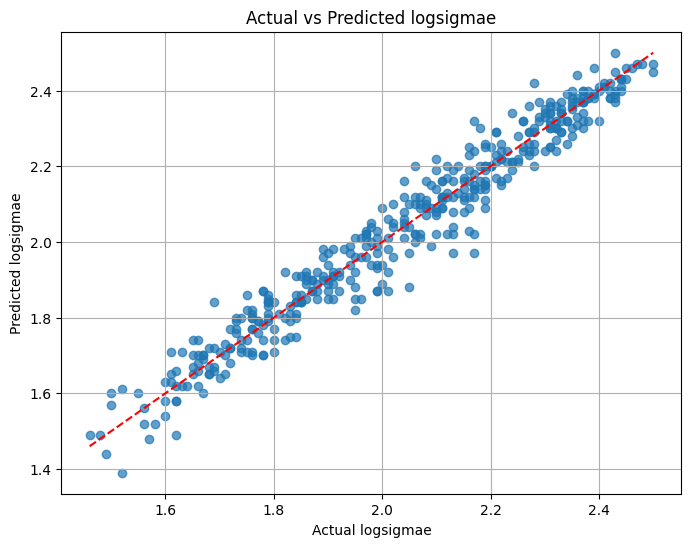

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


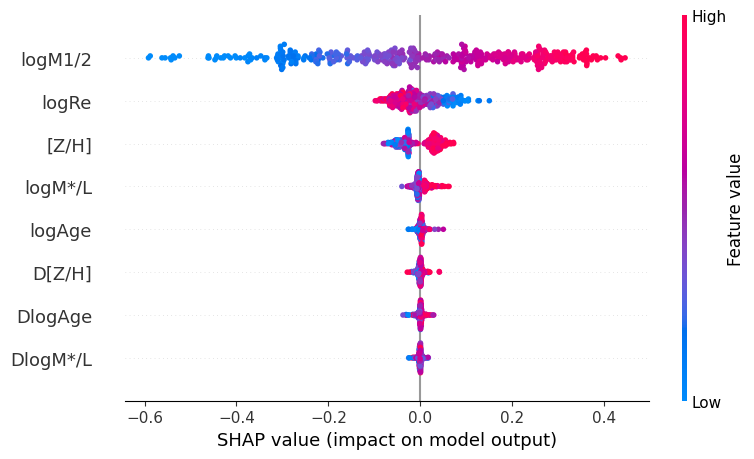

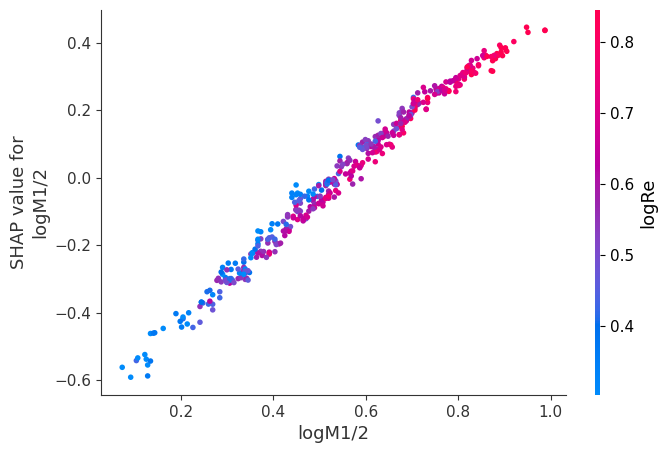

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    training_labels=y_train.values,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test.iloc[sample_index].values,
    dt_model.predict,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.TreeExplainer(dt_model)
shap_values = explainer(X_test, check_additivity=False)

# SHAP summary plot
shap.summary_plot(shap_values.values, X_test, feature_names=features)

# SHAP dependence plot for a specific feature (e.g., first feature)
shap.dependence_plot(0, shap_values.values, X_test, feature_names=features)



# **XGBoost**

In [ ]:
# Rename features to remove special characters
clean_feature_names = {
    'logM1/2': 'logM1_2',
    'logRe': 'logRe',
    'logAge': 'logAge',
    '[Z/H]': 'Z_H',
    'logM*/L': 'logM_ML',
    'DlogAge': 'DlogAge',
    'D[Z/H]': 'DZ_H',
    'DlogM*/L': 'DlogM_ML'
}

data.rename(columns=clean_feature_names, inplace=True)
features = list(clean_feature_names.values())

# Updated dataset split
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost Regressor
xgb_model = XGBRegressor(random_state=42, n_estimators=100)
xgb_model.fit(X_train, y_train)

# Predict and calculate metrics
y_pred = xgb_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Metrics: {'RMSE': 0.03287401672062377, 'MSE': 0.0010807009753478513, 'MAE': 0.025863549257341724, 'R^2': 0.9832037897358902, 'Accuracy RMSE': 97.19025498114327, 'Accuracy MSE': 99.90763239526942, 'Accuracy MAE': 97.78944023441524}


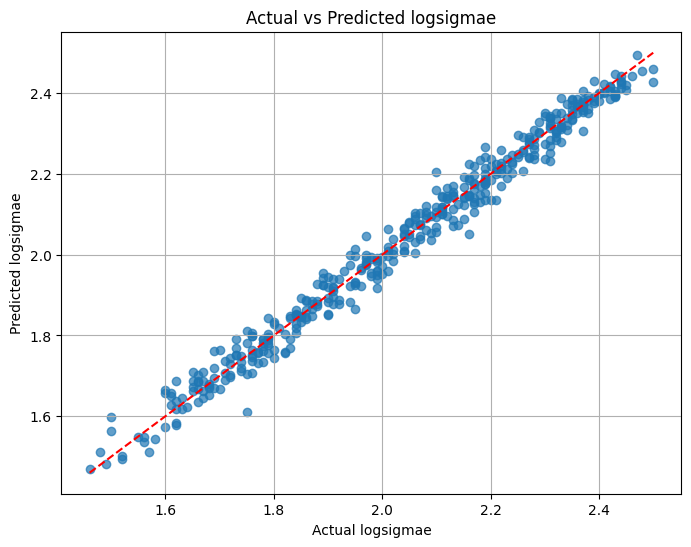

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

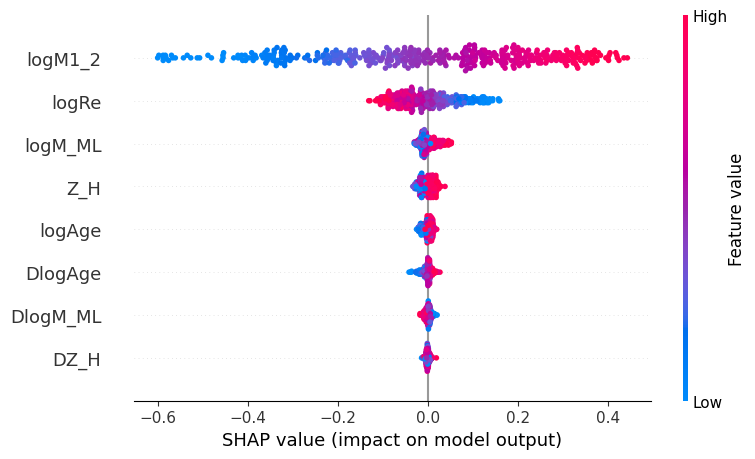

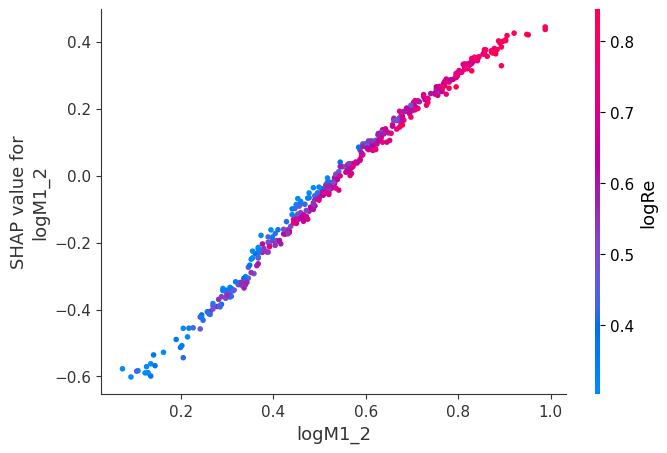

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    training_labels=y_train.values,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test.iloc[sample_index].values,
    xgb_model.predict,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.Explainer(xgb_model, X_train)
shap_values = explainer(X_test)

# SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=features)

# SHAP dependence plot for a specific feature (e.g., first feature)
shap.dependence_plot(0, shap_values.values, X_test, feature_names=features)

# **SVR**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Standardize the features for SVR
scaler = StandardScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize SVR model
svr_model = SVR(kernel='rbf', C=1.0, epsilon=0.1)
svr_model.fit(X_train, y_train)

# Predict and calculate metrics
y_pred = svr_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Metrics: {'RMSE': 0.049885914957437445, 'MSE': 0.002488604511140681, 'MAE': 0.03721051201738933, 'R^2': 0.9613222106884126, 'Accuracy RMSE': 95.7362465848344, 'Accuracy MSE': 99.78729875973157, 'Accuracy MAE': 96.81961435748809}


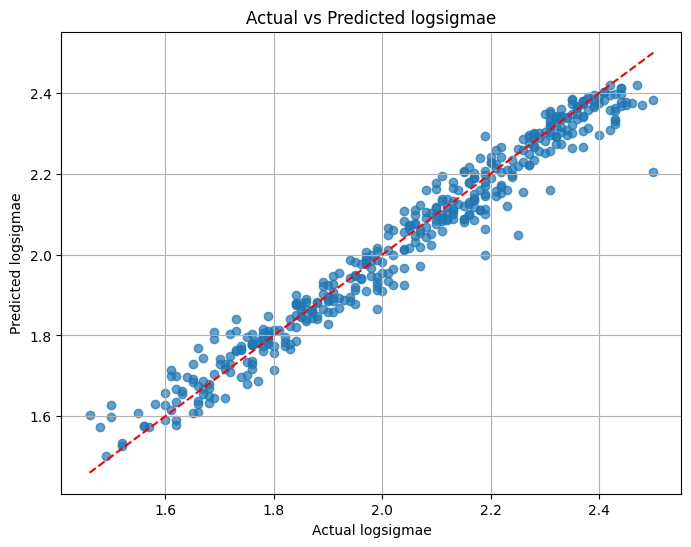

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but SVR was fitted with feature names
  warnings.warn(


ExactExplainer explainer: 423it [01:14,  5.27it/s]


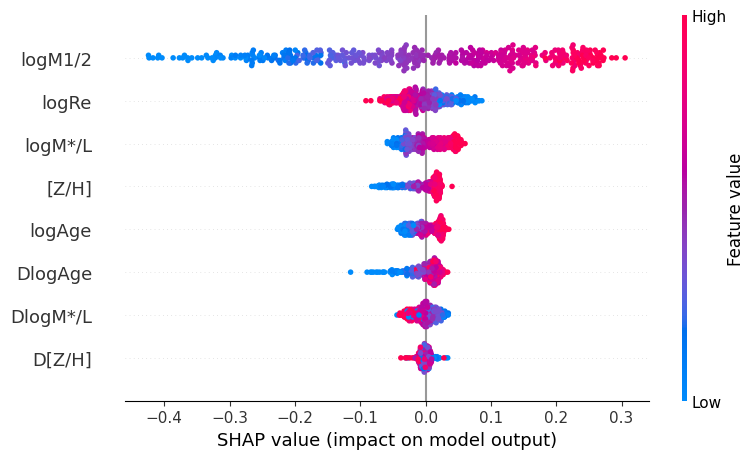

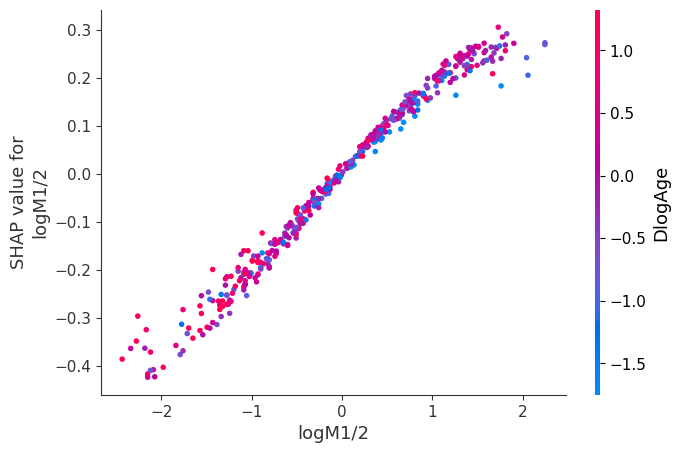

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    training_labels=y_train.values,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test.iloc[sample_index].values,
    svr_model.predict,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.Explainer(svr_model.predict, X_train)
shap_values = explainer(X_test)

# SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=features)

# SHAP dependence plot for a specific feature (e.g., first feature)
shap.dependence_plot(0, shap_values.values, X_test, feature_names=features)

# **LSTM + GRU**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, LSTM, Dense, Dropout

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape data for GRU and LSTM (3D input: samples, timesteps, features)
X_train_reshaped = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_test_reshaped = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

# Build GRU + LSTM model
model = Sequential([
    GRU(64, activation='relu', return_sequences=True, input_shape=(1, X_train.shape[1])),
    Dropout(0.2),
    LSTM(32, activation='relu'),
    Dropout(0.2),
    Dense(1)
])

# Compile the model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the model
history = model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Predict and calculate metrics
y_pred = model.predict(X_test_reshaped).flatten()
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 3.9962 - mae: 1.9833 - val_loss: 2.8085 - val_mae: 1.6636
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.7147 - mae: 1.2058 - val_loss: 0.0768 - val_mae: 0.2193
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.2501 - mae: 0.4042 - val_loss: 0.0701 - val_mae: 0.2116
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.2140 - mae: 0.3734 - val_loss: 0.0646 - val_mae: 0.2077
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.2099 - mae: 0.3694 - val_loss: 0.0382 - val_mae: 0.1571
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.2015 - mae: 0.3591 - val_loss: 0.0370 - val_mae: 0.1575
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1449 - mae: 0.3028 - val_loss: 0.0267 - val_mae: 0.1325
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1354 - mae: 0.2929 - val_loss: 0.0208 - val_mae: 0.1158
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1292 - mae:

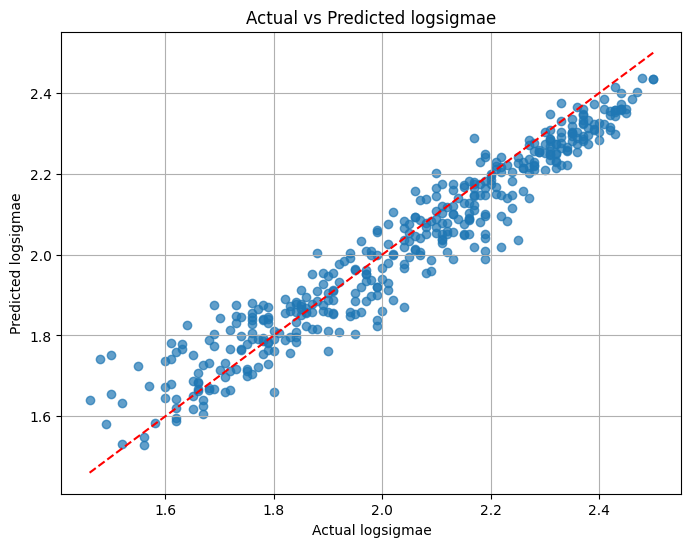

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


  0%|          | 0/50 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
313/313 ━━━━━━

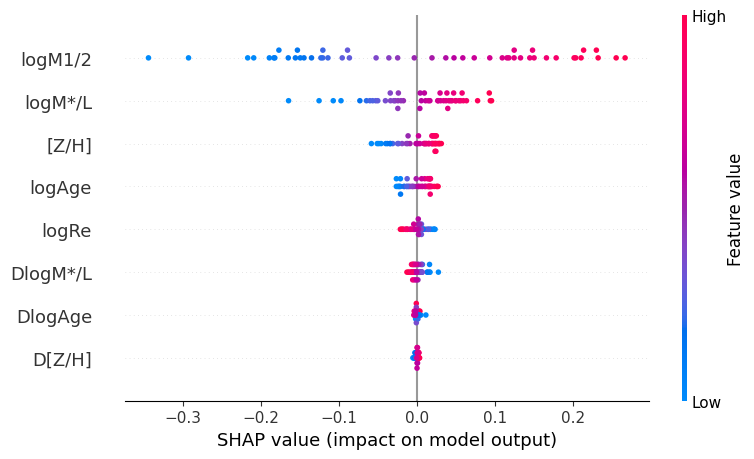

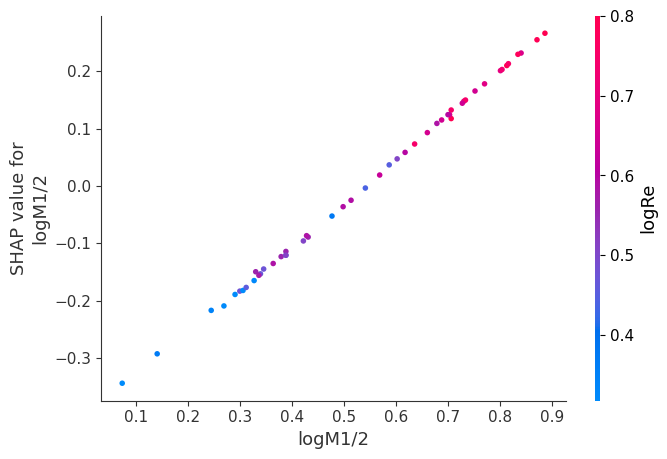

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: model.predict(x.reshape((x.shape[0], 1, x.shape[1]))).flatten(),
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation using KernelExplainer
def predict_function(data):
    # Reshape the input data to 3D as expected by the GRU + LSTM model
    reshaped_data = data.reshape(data.shape[0], 1, data.shape[1])
    return model.predict(reshaped_data).flatten()

# Use a 2D subset of the training data for the explainer
explainer = shap.KernelExplainer(predict_function, X_train[:100])

# Explain a subset of the test data
shap_values = explainer.shap_values(X_test[:50], nsamples=100)  # Use 50 samples for faster computation

# SHAP summary plot
shap.summary_plot(shap_values, X_test[:50], feature_names=features)

# SHAP dependence plot for a specific feature (e.g., feature index 0)
shap.dependence_plot(0, shap_values, X_test[:50], feature_names=features)

# **Attention Based Regression**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, LayerNormalization, Add, Reshape

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape the data for attention (3D input)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build Attention-Based Regression Model
input_layer = Input(shape=(1, X_train.shape[1]))  # 3D input
x = Dense(128, activation='relu')(input_layer)
x = Dropout(0.3)(x)

# Attention Layer
attention = Attention()([x, x])
x = Add()([x, attention])
x = LayerNormalization()(x)

x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(1)(x)  # Regression output
output_layer = Reshape((1,))(x)  # Flatten the output

attention_model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model
attention_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the model
history = attention_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Predict and calculate metrics
y_pred = attention_model.predict(X_test_reshaped).flatten()
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis -1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


43/43 ━━━━━━━━━━━━━━━━━━━━ 6s 25ms/step - loss: 1.2411 - mae: 0.8850 - val_loss: 0.0335 - val_mae: 0.1423
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.2885 - mae: 0.4278 - val_loss: 0.0153 - val_mae: 0.0947
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.2057 - mae: 0.3599 - val_loss: 0.0185 - val_mae: 0.1138
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1913 - mae: 0.3461 - val_loss: 0.0128 - val_mae: 0.0894
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1487 - mae: 0.3047 - val_loss: 0.0086 - val_mae: 0.0714
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1437 - mae: 0.3023 - val_loss: 0.0181 - val_mae: 0.1160
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1241 - mae: 0.2832 - val_loss: 0.0070 - val_mae: 0.0662
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1264 - mae: 0.2792 - val_loss: 0.0130 - val_mae: 0.0939
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1140 - mae: 0.2697 - v

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis -1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


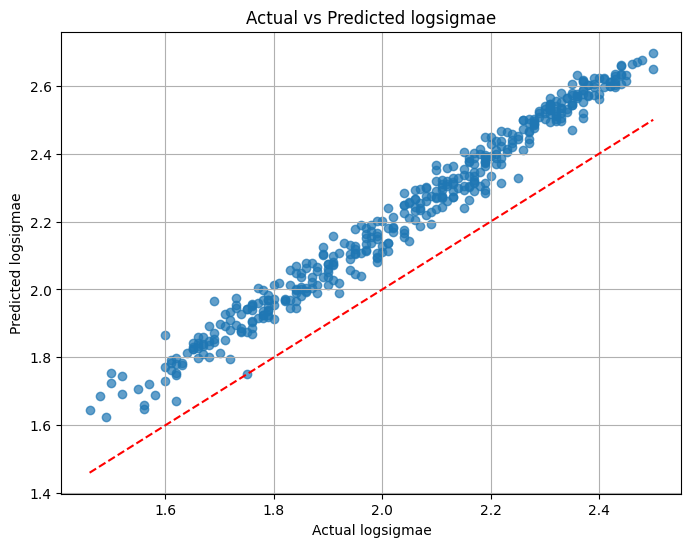

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


  0%|          | 0/50 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
313/313 ━━━━

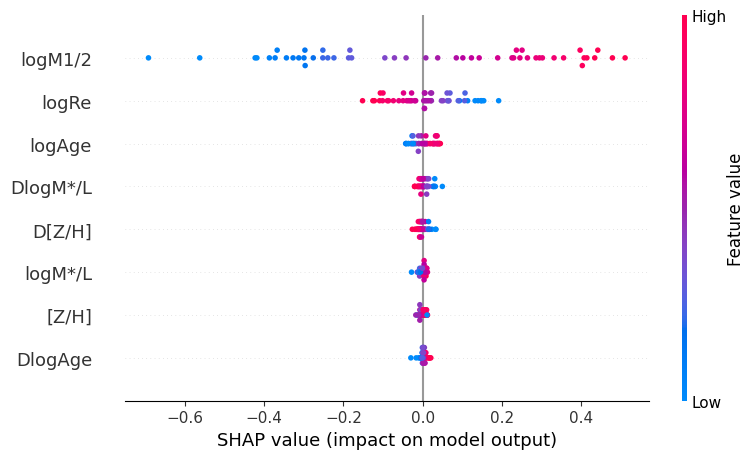

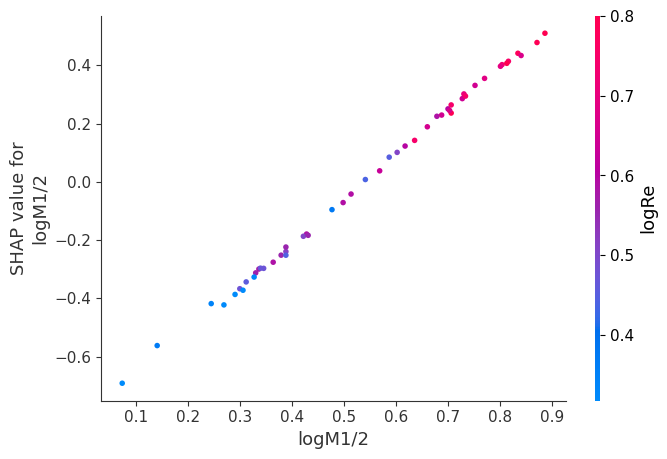

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,  # 2D data for LIME
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: attention_model.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),  # Reshape to 3D
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
# Define a custom prediction function for SHAP
def predict_with_attention(data):
    # Reshape 2D input to 3D as required by the attention model
    reshaped_data = data.reshape(data.shape[0], 1, data.shape[1])
    return attention_model.predict(reshaped_data).flatten()

# Initialize SHAP Explainer with a subset of the training data
explainer = shap.KernelExplainer(predict_with_attention, X_train[:100])  # Use a subset for efficiency

# Explain a subset of the test data
shap_values = explainer.shap_values(X_test[:50], nsamples=100)  # Use 50 samples for faster computation

# SHAP summary plot
shap.summary_plot(shap_values, X_test[:50], feature_names=features)

# SHAP dependence plot for a specific feature (e.g., feature index 0)
shap.dependence_plot(0, shap_values, X_test[:50], feature_names=features)

# **Transformer Based Regression**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
import lime.lime_tabular
import shap
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, LayerNormalization, Add, MultiHeadAttention

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape data for the Transformer model (3D input: samples, timesteps, features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build Transformer-Based Regression Model
input_layer = Input(shape=(1, X_train.shape[1]))  # 3D input for Transformer
x = MultiHeadAttention(num_heads=4, key_dim=64)(input_layer, input_layer)  # Multi-Head Attention
x = Add()([input_layer, x])  # Residual connection
x = LayerNormalization()(x)  # Layer normalization

x = Dense(128, activation='relu')(x)  # Fully connected layer
x = Dropout(0.3)(x)
x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(1)(x)  # Regression output

# Flatten the output
output_layer = tf.keras.layers.Flatten()(x)

transformer_model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model
transformer_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the model
history = transformer_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Predict and calculate metrics
y_pred = transformer_model.predict(X_test_reshaped).flatten()
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (None, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - loss: 1.5570 - mae: 1.0321 - val_loss: 0.0202 - val_mae: 0.1165
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.2004 - mae: 0.3617 - val_loss: 0.0212 - val_mae: 0.1223
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1676 - mae: 0.3333 - val_loss: 0.0145 - val_mae: 0.0937
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1409 - mae: 0.2989 - val_loss: 0.0125 - val_mae: 0.0918
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1351 - mae: 0.2871 - val_loss: 0.0225 - val_mae: 0.1278
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1120 - mae: 0.2657 - val_loss: 0.0247 - val_mae: 0.1369
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0951 - mae: 0.2494 - val_loss: 0.0103 - val_mae: 0.0840
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1003 - mae: 0.2531 - val_loss: 0.0177 - val_mae: 0.1174
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0921 - mae: 0.2442 - v

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (32, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Metrics: {'RMSE': 0.037162653729152, 'MSE': 0.0013810628321928552, 'MAE': 0.02956960860021871, 'R^2': 0.9785355780677519, 'Accuracy RMSE': 96.8237048094742, 'Accuracy MSE': 99.88196044169293, 'Accuracy MAE': 97.47268302562233}


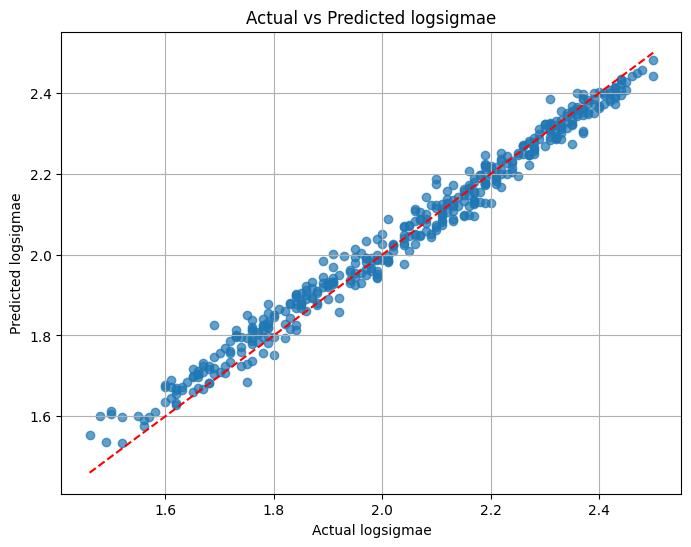

In [ ]:
# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


  0%|          | 0/50 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
313/313 ━━━━━━

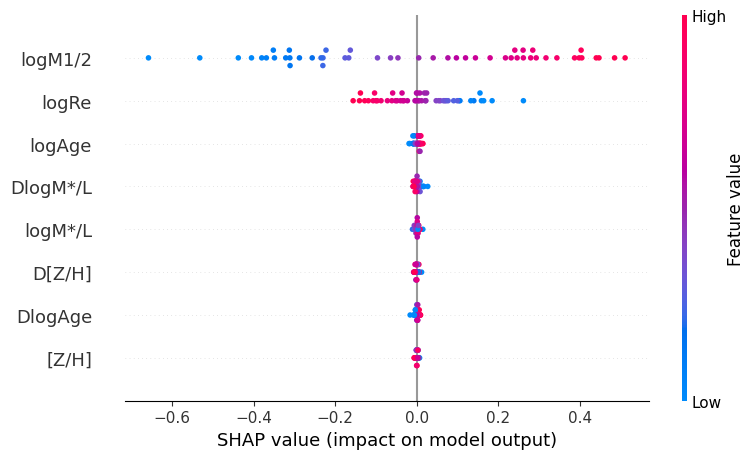

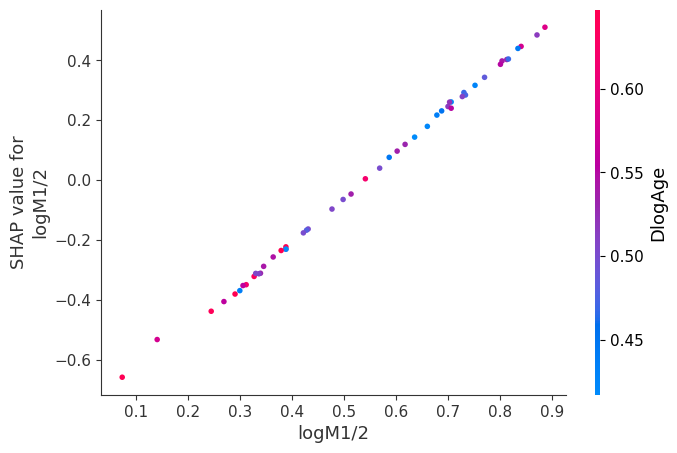

In [ ]:
# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: transformer_model.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
def predict_with_transformer(data):
    reshaped_data = data.reshape(data.shape[0], 1, data.shape[1])  # Reshape for Transformer
    return transformer_model.predict(reshaped_data).flatten()

explainer = shap.KernelExplainer(predict_with_transformer, X_train[:100])  # Subset for efficiency
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

# SHAP summary plot
shap.summary_plot(shap_values, X_test[:50], feature_names=features)

# SHAP dependence plot for a specific feature (e.g., feature index 0)
shap.dependence_plot(0, shap_values, X_test[:50], feature_names=features)

# **Ensemble using Linear Regression, Random Forest, and XGBoost**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Linear Regression
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
y_pred_lr = lr_model.predict(X_test)

# Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_test)

# XGBoost
xgb_model = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=5, random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

In [ ]:
# Ensemble Predictions: Averaging
y_pred_ensemble = (y_pred_lr + y_pred_rf + y_pred_xgb) / 3

# Calculate metrics
def calculate_metrics(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
    accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
    accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100
    return {
        "RMSE": rmse,
        "MSE": mse,
        "MAE": mae,
        "R^2": r2,
        "Accuracy RMSE": accuracy_rmse,
        "Accuracy MSE": accuracy_mse,
        "Accuracy MAE": accuracy_mae,
    }

metrics_ensemble = calculate_metrics(y_test, y_pred_ensemble)
print("Ensemble Metrics:", metrics_ensemble)

Ensemble Metrics: {'RMSE': 0.02916856899924956, 'MSE': 0.0008508054174639826, 'MAE': 0.02272354805505825, 'R^2': 0.9867768170737802, 'Accuracy RMSE': 97.50695991459406, 'Accuracy MSE': 99.92728158825093, 'Accuracy MAE': 98.05781640555058}


  0%|          | 0/50 [00:00<?, ?it/s]

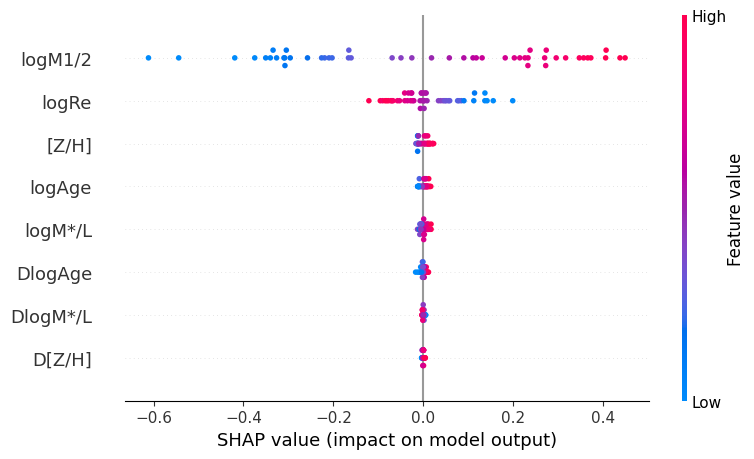

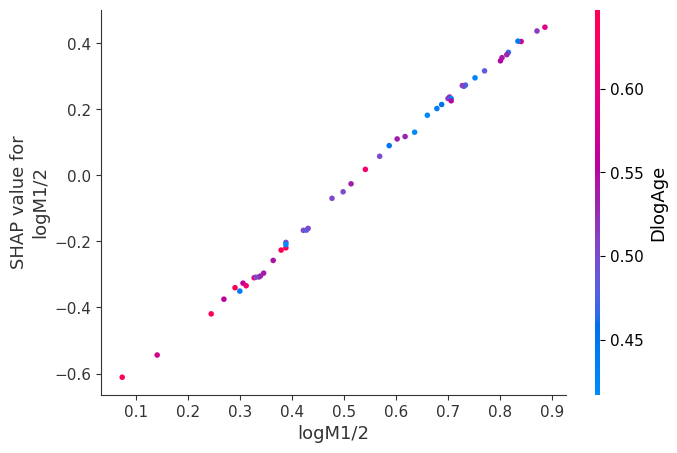

In [ ]:
# LIME Explanation
import lime.lime_tabular

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: (lr_model.predict(x) + rf_model.predict(x) + xgb_model.predict(x)) / 3,
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
import shap

def predict_ensemble(data):
    lr_preds = lr_model.predict(data)
    rf_preds = rf_model.predict(data)
    xgb_preds = xgb_model.predict(data)
    return (lr_preds + rf_preds + xgb_preds) / 3

explainer = shap.KernelExplainer(predict_ensemble, X_train[:100])  # Subset for efficiency
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

# SHAP summary plot
shap.summary_plot(shap_values, X_test[:50], feature_names=features)

# SHAP dependence plot for a specific feature (e.g., feature index 0)
shap.dependence_plot(0, shap_values, X_test[:50], feature_names=features)

# **Ensemble using LSTM + GRU, Attention-Based Regression, and Transformer-Based Regression**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Dense, Dropout, LSTM, GRU, Attention, Add, LayerNormalization, Flatten, MultiHeadAttention
from sklearn.ensemble import VotingRegressor

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape data for models that need 3D input
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build LSTM + GRU model
lstm_gru_model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(1, X_train.shape[1])),
    GRU(32, return_sequences=False),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(1)
])
lstm_gru_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train LSTM + GRU model
lstm_gru_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Build Attention-Based Regression model
input_layer = Input(shape=(1, X_train.shape[1]))
x = Attention()([input_layer, input_layer])
x = Dense(128, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(1)(x)
output_layer = Flatten()(x)
attention_model = Model(inputs=input_layer, outputs=output_layer)
attention_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train Attention-Based Regression model
attention_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Build Transformer-Based Regression model
transformer_input = Input(shape=(1, X_train.shape[1]))
x = MultiHeadAttention(num_heads=4, key_dim=64)(transformer_input, transformer_input)
x = Add()([transformer_input, x])
x = LayerNormalization()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(1)(x)
transformer_output = Flatten()(x)
transformer_model = Model(inputs=transformer_input, outputs=transformer_output)
transformer_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train Transformer-Based Regression model
transformer_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


43/43 ━━━━━━━━━━━━━━━━━━━━ 6s 23ms/step - loss: 2.7829 - mae: 1.5513 - val_loss: 0.0916 - val_mae: 0.2785
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.1758 - mae: 0.3363 - val_loss: 0.0182 - val_mae: 0.1135
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.1445 - mae: 0.3036 - val_loss: 0.0131 - val_mae: 0.0911
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.1106 - mae: 0.2645 - val_loss: 0.0183 - val_mae: 0.1153
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.1113 - mae: 0.2669 - val_loss: 0.0127 - val_mae: 0.0936
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0893 - mae: 0.2343 - val_loss: 0.0153 - val_mae: 0.1051
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0817 - mae: 0.2291 - val_loss: 0.0092 - val_mae: 0.0730
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0833 - mae: 0.2286 - val_loss: 0.0079 - val_mae: 0.0693
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0839 - mae: 0.2316 

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis -1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


43/43 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 2.2906 - mae: 1.3508 - val_loss: 0.0385 - val_mae: 0.1593
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.2045 - mae: 0.3656 - val_loss: 0.0267 - val_mae: 0.1380
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1589 - mae: 0.3143 - val_loss: 0.0156 - val_mae: 0.1020
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1318 - mae: 0.2900 - val_loss: 0.0132 - val_mae: 0.0931
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1118 - mae: 0.2668 - val_loss: 0.0138 - val_mae: 0.0973
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1080 - mae: 0.2635 - val_loss: 0.0195 - val_mae: 0.1206
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0955 - mae: 0.2469 - val_loss: 0.0281 - val_mae: 0.1493
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1016 - mae: 0.2543 - val_loss: 0.0088 - val_mae: 0.0747
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0918 - mae: 0.2393 - va

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (None, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


43/43 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 1.2231 - mae: 0.8825 - val_loss: 0.0366 - val_mae: 0.1602
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1986 - mae: 0.3545 - val_loss: 0.0311 - val_mae: 0.1472
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1770 - mae: 0.3377 - val_loss: 0.0210 - val_mae: 0.1203
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1522 - mae: 0.3153 - val_loss: 0.0165 - val_mae: 0.1000
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1219 - mae: 0.2768 - val_loss: 0.0291 - val_mae: 0.1434
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1121 - mae: 0.2674 - val_loss: 0.0170 - val_mae: 0.1077
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1033 - mae: 0.2576 - val_loss: 0.0113 - val_mae: 0.0857
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1008 - mae: 0.2518 - val_loss: 0.0120 - val_mae: 0.0839
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1109 - mae: 0.2657 - v

In [ ]:
# Ensemble using Weighted Averaging
def weighted_ensemble_predict(X):
    lstm_gru_preds = lstm_gru_model.predict(X.reshape(X.shape[0], 1, X.shape[1])).flatten()
    attention_preds = attention_model.predict(X.reshape(X.shape[0], 1, X.shape[1])).flatten()
    transformer_preds = transformer_model.predict(X.reshape(X.shape[0], 1, X.shape[1])).flatten()

    # Dynamic weights based on validation performance
    weights = [0.4, 0.3, 0.3]  # Adjust based on validation metrics
    ensemble_preds = (weights[0] * lstm_gru_preds +
                      weights[1] * attention_preds +
                      weights[2] * transformer_preds)
    return ensemble_preds

# Predict and calculate metrics
y_pred = weighted_ensemble_predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

# Display metrics
metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)

14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis -1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 137ms/step

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (32, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
Metrics: {'RMSE': 0.04963735413355742, 'MSE': 0.0024638669253801895, 'MAE': 0.04192876725400228, 'R^2': 0.9617066812323815, 'Accuracy RMSE': 95.75749109969594, 'Accuracy MSE': 99.78941308330084, 'Accuracy MAE': 96.41634467914511}


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


Input shape for models: (100, 8)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


  0%|          | 0/50 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━

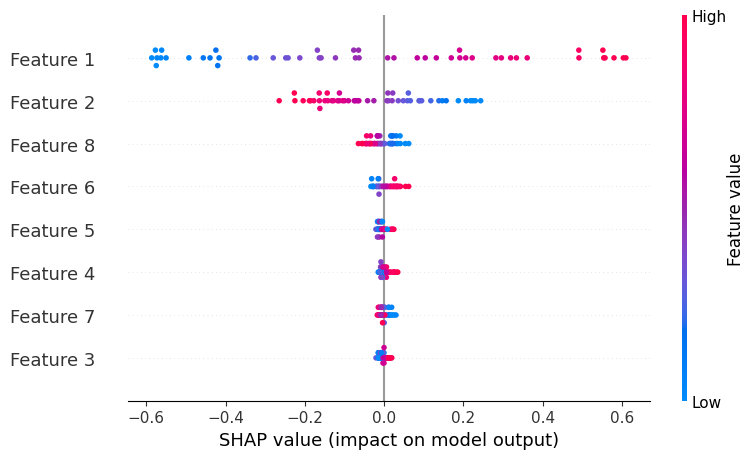

In [ ]:

# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: weighted_ensemble_predict(x),
    num_features=len(features)
)

lime_exp.show_in_notebook()

import numpy as np
import shap

# Example data (replace with your actual dataset)
X_train = np.random.rand(100, 8)  # 100 samples, 8 features
X_test = np.random.rand(50, 8)    # 50 samples, 8 features

# Ensure input is reshaped correctly for models
def weighted_ensemble_predict(X):
    """
    Weighted ensemble prediction combining LSTM+GRU, Attention, and Transformer models.
    """
    X_reshaped = X.reshape(X.shape[0], 1, X.shape[1])  # Add time dimension for models
    lstm_gru_preds = lstm_gru_model.predict(X_reshaped).flatten()
    attention_preds = attention_model.predict(X_reshaped).flatten()
    transformer_preds = transformer_model.predict(X_reshaped).flatten()

    # Weighted averaging of predictions
    return (0.4 * lstm_gru_preds + 0.3 * attention_preds + 0.3 * transformer_preds)

# Validate the shape of the reshaped input (debugging step)
print("Input shape for models:", X_train.shape)

# Define a prediction function for SHAP that ensures proper input reshaping
def predict_with_ensemble(data):
    return weighted_ensemble_predict(data)

# SHAP KernelExplainer for explainability
explainer = shap.KernelExplainer(predict_with_ensemble, X_train[:100])  # Subset for efficiency
shap_values = explainer.shap_values(X_test[:50], nsamples=100)  # Explanation on subset of data

# Dynamically generate feature names
feature_names = [f"Feature {i+1}" for i in range(X_test.shape[1])]

# Visualize SHAP values (summary plot)
shap.summary_plot(shap_values, X_test[:50], feature_names=feature_names)


# **Hybrid Ensemble using Decision Tree, SVR, and Transformer-Based Regression**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import StackingRegressor
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, LayerNormalization, Add, MultiHeadAttention

# Load dataset
file_path = "/content/tablea1.csv"
data = pd.read_csv(file_path)

# Define features and target
features = ['logM1/2', 'logRe', 'logAge', '[Z/H]', 'logM*/L', 'DlogAge', 'D[Z/H]', 'DlogM*/L']
target = 'logsigmae'

# Handle missing values with mean
data[features] = data[features].fillna(data[features].mean())

# Min-max normalization
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Split the data into train and test sets
X = data[features].values
y = data[target].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Phase 1: Boosting with Decision Tree and SVR
decision_tree = DecisionTreeRegressor(max_depth=5, random_state=42)
svr = SVR(kernel='rbf', C=1.0, epsilon=0.1)
boosted_model = AdaBoostRegressor(estimator=svr, n_estimators=50, random_state=42)

# Train boosted ensemble
boosted_model.fit(X_train, y_train)

# Predictions from boosted model
boosted_preds = boosted_model.predict(X_test)

# Phase 2: Transformer-Based Regression
# Reshape data for Transformer model (3D input: samples, timesteps, features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

input_layer = Input(shape=(1, X_train.shape[1]))
x = MultiHeadAttention(num_heads=4, key_dim=64)(input_layer, input_layer)
x = Add()([input_layer, x])
x = LayerNormalization()(x)

x = Dense(128, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(1)(x)

output_layer = tf.keras.layers.Flatten()(x)
transformer_model = Model(inputs=input_layer, outputs=output_layer)

transformer_model.compile(optimizer='adam', loss='mse', metrics=['mae'])
transformer_model.fit(X_train_reshaped, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Transformer predictions
transformer_preds = transformer_model.predict(X_test_reshaped).flatten()

# Phase 3: Weighted Stacking
stacked_model = StackingRegressor(
    estimators=[('boosted', boosted_model)],
    final_estimator=LinearRegression()
)
stacked_model.fit(X_train, y_train)

stacked_preds = stacked_model.predict(X_test)

# Calculate Metrics
rmse = np.sqrt(mean_squared_error(y_test, stacked_preds))
mse = mean_squared_error(y_test, stacked_preds)
mae = mean_absolute_error(y_test, stacked_preds)
r2 = r2_score(y_test, stacked_preds)
accuracy_rmse = (1 - (rmse / (y.max() - y.min()))) * 100
accuracy_mse = (1 - (mse / (y.max() - y.min()))) * 100
accuracy_mae = (1 - (mae / (y.max() - y.min()))) * 100

metrics = {
    "RMSE": rmse,
    "MSE": mse,
    "MAE": mae,
    "R^2": r2,
    "Accuracy RMSE": accuracy_rmse,
    "Accuracy MSE": accuracy_mse,
    "Accuracy MAE": accuracy_mae
}

print("Metrics:", metrics)


Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (None, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


43/43 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - loss: 2.6104 - mae: 1.4013 - val_loss: 0.0691 - val_mae: 0.2226
Epoch 2/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.2259 - mae: 0.3802 - val_loss: 0.0299 - val_mae: 0.1438
Epoch 3/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.1903 - mae: 0.3510 - val_loss: 0.0389 - val_mae: 0.1696
Epoch 4/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1502 - mae: 0.3081 - val_loss: 0.0171 - val_mae: 0.1086
Epoch 5/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.1308 - mae: 0.2867 - val_loss: 0.0137 - val_mae: 0.0915
Epoch 6/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1335 - mae: 0.2925 - val_loss: 0.0116 - val_mae: 0.0887
Epoch 7/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1259 - mae: 0.2843 - val_loss: 0.0120 - val_mae: 0.0906
Epoch 8/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1213 - mae: 0.2704 - val_loss: 0.0300 - val_mae: 0.1546
Epoch 9/50
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1069 - mae: 0.2619 -

/usr/local/lib/python3.10/dist-packages/keras/src/ops/nn.py:545: UserWarning: You are using a softmax over axis 3 of a tensor of shape (32, 4, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Metrics: {'RMSE': 0.04596577712063611, 'MSE': 0.0021128526663039943, 'MAE': 0.0349099655015031, 'R^2': 0.9671621304599042, 'Accuracy RMSE': 96.07130110080033, 'Accuracy MSE': 99.8194143020253, 'Accuracy MAE': 97.0162422648288}


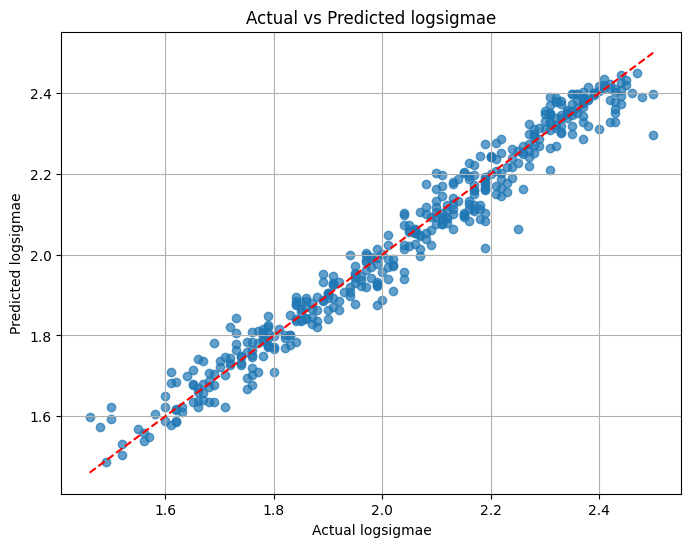

In [ ]:
import matplotlib.pyplot as plt

# Visualize predictions vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, stacked_preds, alpha=0.7)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual logsigmae")
plt.ylabel("Predicted logsigmae")
plt.title("Actual vs Predicted logsigmae")
plt.grid()
plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]

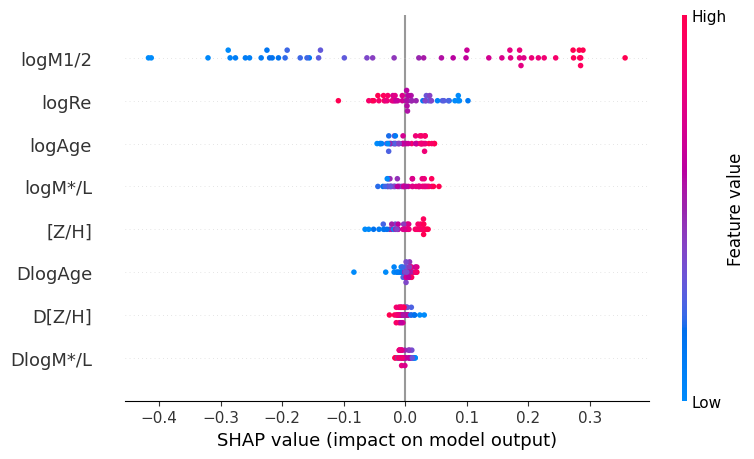

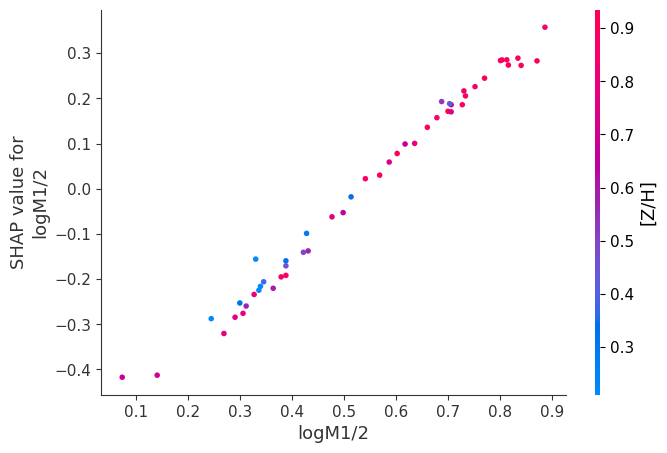

In [ ]:
import lime.lime_tabular
import shap

# LIME Explanation
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    training_labels=y_train,
    feature_names=features,
    mode='regression'
)

sample_index = 0  # Example: Explain the first test sample
lime_exp = lime_explainer.explain_instance(
    X_test[sample_index],
    lambda x: stacked_model.predict(x),
    num_features=len(features)
)

lime_exp.show_in_notebook()

# SHAP Explanation
explainer = shap.KernelExplainer(stacked_model.predict, X_train[:100])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

# SHAP summary plot
shap.summary_plot(shap_values, X_test[:50], feature_names=features)

# SHAP dependence plot for a specific feature
shap.dependence_plot(0, shap_values, X_test[:50], feature_names=features)